References:<br />
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;http://stackoverflow.com/questions/6136588/image-cropping-using-python <br/>
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;http://2017.compciv.org/guide/topics/python-nonstandard-libraries/pillow.html

In [2]:
Introduction to Image processing with Jupyter notebook. It uses various easy to install modules, 
such as matplotlib, Pil image and OpenCV. This notebook was created on Ubuntu linux 16.04. Quite often
the versions of modules used in order to assure compatability. 

In [1]:
# This cell uses a 'magic' to execute the bash command < mkdir images >
# once executed it will make a directory images, where images can be downloaded and stored
!mkdir images

In [4]:
# This cell uses a 'magic' to execute the bash command wget- notice the < -O desert.jpg >
#that saves the downloaded file "Nevada_desert.JPG" as "desert.jpg" into the images/ directory
!wget -O images/desert.jpg https://upload.wikimedia.org/wikipedia/en/f/f4/Nevada_desert.JPG

--2017-07-11 08:30:25--  https://upload.wikimedia.org/wikipedia/en/f/f4/Nevada_desert.JPG
Resolving upload.wikimedia.org (upload.wikimedia.org)... 198.35.26.112, 2620:0:863:ed1a::2:b
Connecting to upload.wikimedia.org (upload.wikimedia.org)|198.35.26.112|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1658089 (1.6M) [image/jpeg]
Saving to: ‘images/desert.jpg’

images/desert.jpg   100%[===================>]   1.58M   243KB/s    in 6.8s    

2017-07-11 08:30:33 (239 KB/s) - ‘images/desert.jpg’ saved [1658089/1658089]



In [5]:
# verify the existance of "desert.jpg" in the images directory
!ls images

desert.jpg


In [6]:
#Using the Python Image Library PILopen the image and get it's dimensions.
from PIL import Image
im=Image.open('images/desert.jpg')
im.size # (width,height) tuple

(2048, 1536)

In [8]:
#verify the new size
from PIL import Image
im=Image.open("images/resized-desert.jpg")
im.size # (width,height) tuple

(650, 487)

In [101]:
# Using PIL resize the image
import PIL
from PIL import Image

#open the image
img = Image.open("images/desert.jpg")

#The basewidth desired for the new image
basewidth = 650

wpercent = (basewidth / float(img.size[0]))
hsize = int((float(img.size[1]) * float(wpercent)))

#the actual resize command
img = img.resize((basewidth, hsize), PIL.Image.ANTIALIAS)

#save the image in the imagesdirectory
img.save("images/resized-desert.jpg")

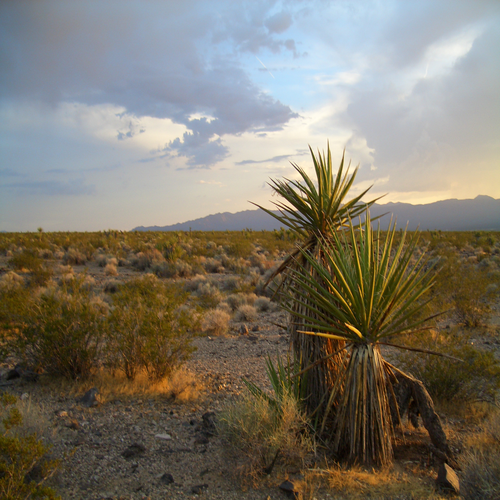

In [85]:
# A totally manual resize - it will resize reguardless of original aspect
import PIL
from PIL import Image
im0 = Image.open("images/desert.jpg")
#longer_side = max(im1.size)
basewidth = 500
hsize = 500
man = im0.resize((basewidth, hsize), PIL.Image.ANTIALIAS)
man.save("images/manual_desert.jpg")
man

<span style = "font-size:24px;">&nbsp;&nbsp;&nbsp;&nbsp;Viewing an image with PIL.</span><br /><span style = "font-size:20px"> The <b>img</b> of &nbsp;&nbsp;&nbsp;&nbsp;<i>img = Image.open("images/resized-desert.jpg")</i> is a variable representing the image object.</span> <br />&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;<span style = "font-size:16px">The variable assigned will be remembered as long as it is not reused to identify another object.<br/>
To explain a bit further, supose we want to open multiple images at once. There are several reasons to do this. One example is to overlay one image on top of another. In that case the variable of the second image must be changed. Notice the example, the img is changed to something that appropriately represents the objects/files being used.<br />
Example:<br />
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;orig = Image.open("images/desert.jpg")<br />
&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;&nbsp;resize = Image.open("images/resized-desert.jpg")<br /></span>

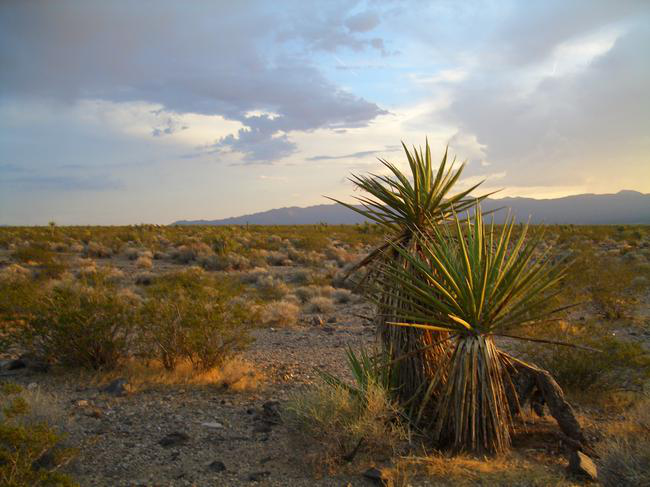

In [14]:
# Viewing an image with PIL the img of 'img = Image.open("images/resized-desert.jpg")'
import PIL
from PIL import Image
resize  = Image.open("images/resized-desert.jpg")
resize 

### View the image with matplotlib



In [ ]:
Using matplotlib to view an image will allow a view showing aproximate pixel locations.
The scaleon the side is handy if image cropping is required.


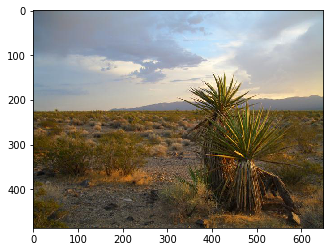

In [15]:
import matplotlib.pyplot as plt
%matplotlib inline 
import matplotlib.image as mpimg
import numpy as np
resize = mpimg.imread('images/resized-desert.jpg')
imgplot = plt.imshow(resize)


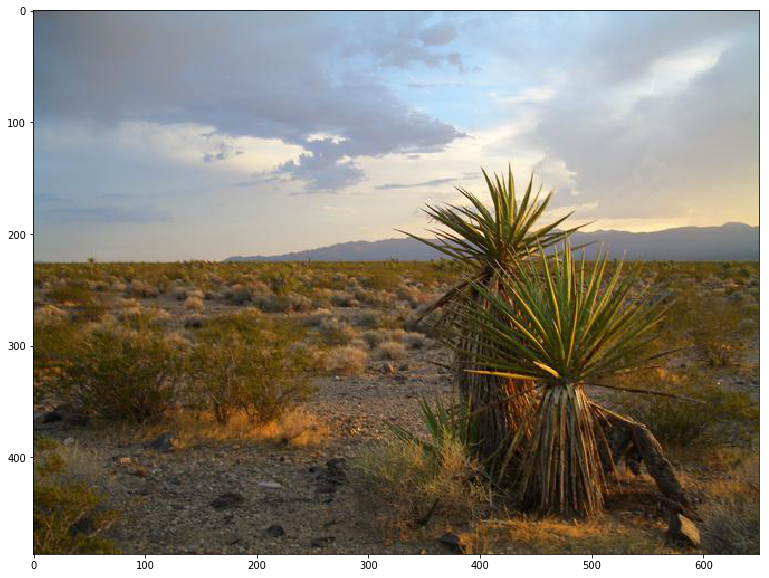

In [18]:
#Notice here the object was changed to img1
import matplotlib.pyplot as plt
%matplotlib inline
# the image above is the standard size of a matplotlib plt
# the following line resizes the view (20.0, 10.0). You may experiment with the numbers.
plt.rcParams['figure.figsize'] = (20.0, 10.0)

import matplotlib.image as mpimg
import numpy as np
img1=mpimg.imread('images/resized-desert.jpg')
imgplot = plt.imshow(img1)


### Crop spects tuple:
crop_specs = (upper_left_width, upper_left_height and lower_left_width, lower_left_height )

In [42]:
#Notice ! The image may be saved as jpg or by png
from PIL import Image
img3 = Image.open('images/resized-desert.jpg')
crop_specs = (300, 125, 610, 462)
crop_img = img3.crop(crop_specs)
crop_img.save('images/crop_specsimage.png')   

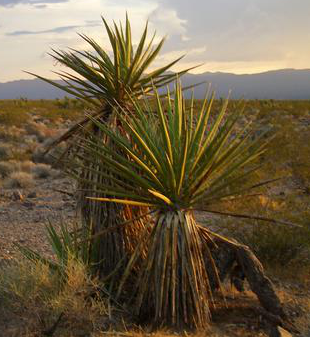

In [43]:
from PIL import Image
im3=Image.open('images/crop_specsimage.png')
im3.size # (width,height) tuple
im3

# Info on http://mpld3.github.io/

#### This module will allow a mouse position to be shown on the image if more precise 
#### co-ordinates are required for image processing.
## This command will install the module:
## !conda install --yes mpld3

# Using mpld3 to show co-ordinates on an image

In [58]:
#The mouse co-ordinates will be shown on the lower right side of the image.
import matplotlib
import numpy as np
import mpld3
import matplotlib.pyplot as plt
from PIL import Image
from mpld3 import plugins
%matplotlib inline
fig, ax = plt.subplots()
im = np.array(Image.open('images/resized-desert.jpg'))
plt.imshow(im)
plugins.connect(fig, plugins.MousePosition(fontsize=20))

mpld3.display()

In [59]:
#The mouse co-ordinates will be shown on the lower right side of the image.
import matplotlib
import numpy as np
import mpld3
import matplotlib.pyplot as plt
from PIL import Image
from mpld3 import plugins
%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0)

fig, ax = plt.subplots()
im = np.array(Image.open('images/crop_specsimage.png'))
plt.imshow(im)
plugins.connect(fig, plugins.MousePosition(fontsize=20))

mpld3.display()

# Gives a popup window Points Clicked will be recorded
### Cut and past the check points

In [82]:
import Tkinter
from PIL import Image, ImageTk
from sys import argv

window = Tkinter.Tk(className="Crop Tool")

image = Image.open("images/crop_specsimage.png")
canvas = Tkinter.Canvas(window, width=image.size[0], height=image.size[1])
canvas.pack()
image_tk = ImageTk.PhotoImage(image)
canvas.create_image(image.size[0]//2, image.size[1]//2, image=image_tk)

def callback(event):
    print "[",event.x,",", event.y,"],"

canvas.bind("<Button-1>", callback)
Tkinter.mainloop()

[ 14 , 66 ],
[ 45 , 45 ],
[ 70 , 25 ],
[ 98 , 12 ],
[ 126 , 6 ],
[ 154 , 16 ],
[ 171 , 34 ],
[ 189 , 54 ],
[ 212 , 67 ],
[ 206 , 82 ],
[ 236 , 85 ],
[ 282 , 136 ],
[ 268 , 171 ],
[ 265 , 207 ],
[ 260 , 237 ],
[ 304 , 317 ],
[ 267 , 329 ],
[ 234 , 290 ],
[ 204 , 329 ],
[ 131 , 313 ],
[ 84 , 255 ],
[ 82 , 223 ],
[ 122 , 210 ],
[ 80 , 202 ],
[ 65 , 165 ],
[ 61 , 152 ],
[ 30 , 159 ],
[ 81 , 109 ],
[ 9 , 66 ],


## USING those " Points Clicked "

In [83]:
import cv2
import numpy as np 

# Read images
dst = cv2.imread("images/resized-desert.jpg")

src = cv2.imread("images/crop_specsimage.png")


# Create a rough mask around the cactus.
src_mask = np.zeros(src.shape, src.dtype)

poly = np.array([
[ 14 , 66 ],
[ 45 , 45 ],
[ 70 , 25 ],
[ 98 , 12 ],
[ 126 , 6 ],
[ 154 , 16 ],
[ 171 , 34 ],
[ 189 , 54 ],
[ 212 , 67 ],
[ 206 , 82 ],
[ 236 , 85 ],
[ 282 , 136 ],
[ 268 , 171 ],
[ 265 , 207 ],
[ 260 , 237 ],
[ 304 , 317 ],
[ 267 , 329 ],
[ 234 , 290 ],
[ 204 , 329 ],
[ 131 , 313 ],
[ 84 , 255 ],
[ 82 , 223 ],
[ 122 , 210 ],
[ 80 , 202 ],
[ 65 , 165 ],
[ 61 , 152 ],
[ 30 , 159 ],
[ 81 , 109 ],
[ 9 , 66 ]
], np.int32)


cv2.fillPoly(src_mask, [poly], (255, 255, 255))

# This is where the CENTER where the cactus will be placed. If it overlaps the bottomimage edge
# it will give an error.

center = (160,300)

# Clone seamlessly.
output = cv2.seamlessClone(src, dst, src_mask, center, cv2.NORMAL_CLONE)

# Write result
cv2.imwrite("images/paste2_image.png", output);


In [84]:
#Result of cv2.seamlessClone
# Use the mouse below and 
#Notice the center of the overlaid image center = (160,300)
import matplotlib
import numpy as np
import mpld3
import matplotlib.pyplot as plt
from PIL import Image
from mpld3 import plugins
%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0)

fig, ax = plt.subplots()
im = np.array(Image.open('images/paste2_image.png'))
plt.imshow(im)
plugins.connect(fig, plugins.MousePosition(fontsize=20))

mpld3.display()

# Grabcut

In [87]:
!wget -O images/flower.jpg https://i1.wp.com/theheavensdeclare.net/wp-content/uploads/2012/08/WiltedRose-wikimedia-public-domain.jpg?ssl=1

--2017-07-11 11:43:36--  https://i1.wp.com/theheavensdeclare.net/wp-content/uploads/2012/08/WiltedRose-wikimedia-public-domain.jpg?ssl=1
Resolving i1.wp.com (i1.wp.com)... 192.0.77.2
Connecting to i1.wp.com (i1.wp.com)|192.0.77.2|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 42732 (42K) [image/jpeg]
Saving to: ‘images/flower.jpg’

images/flower.jpg   100%[===================>]  41.73K   247KB/s    in 0.2s    

2017-07-11 11:43:37 (247 KB/s) - ‘images/flower.jpg’ saved [42732/42732]



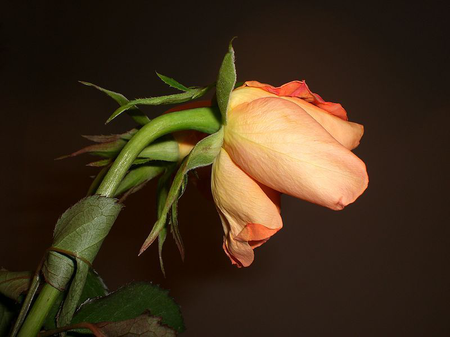

In [4]:
# Using PIL resize the image
import PIL
from PIL import Image

#open the image
img = Image.open("images/flower.jpg")

#The basewidth desired for the new image
basewidth = 450

wpercent = (basewidth / float(img.size[0]))
hsize = int((float(img.size[1]) * float(wpercent)))

#the actual resize command
img = img.resize((basewidth, hsize), PIL.Image.ANTIALIAS)

#save the image in the imagesdirectory
img.save("images/resized-flower.jpg")
img

In [5]:
import Tkinter
from PIL import Image, ImageTk
from sys import argv

window = Tkinter.Tk(className="Crop Tool")

image = Image.open("images/resized-flower.jpg")
canvas = Tkinter.Canvas(window, width=image.size[0], height=image.size[1])
canvas.pack()
image_tk = ImageTk.PhotoImage(image)
canvas.create_image(image.size[0]//2, image.size[1]//2, image=image_tk)

def callback(event):
    print "[",event.x,",", event.y,"],"

canvas.bind("<Button-1>", callback)
Tkinter.mainloop()

[ 9 , 322 ],
[ 42 , 244 ],
[ 61 , 195 ],
[ 99 , 173 ],
[ 48 , 161 ],
[ 115 , 105 ],
[ 69 , 74 ],
[ 136 , 94 ],
[ 168 , 89 ],
[ 150 , 66 ],
[ 207 , 83 ],
[ 232 , 28 ],
[ 243 , 75 ],
[ 311 , 71 ],
[ 355 , 98 ],
[ 374 , 122 ],
[ 363 , 152 ],
[ 380 , 189 ],
[ 337 , 217 ],
[ 281 , 198 ],
[ 291 , 226 ],
[ 260 , 249 ],
[ 251 , 272 ],
[ 230 , 271 ],
[ 216 , 243 ],
[ 206 , 171 ],
[ 191 , 178 ],
[ 185 , 208 ],
[ 194 , 262 ],
[ 172 , 243 ],
[ 170 , 278 ],
[ 149 , 255 ],
[ 136 , 263 ],
[ 160 , 180 ],
[ 130 , 201 ],
[ 98 , 263 ],
[ 81 , 298 ],
[ 79 , 327 ],
[ 12 , 332 ],


In [13]:
import cv2
import numpy as np 

# Read images
dst = cv2.imread("images/paste2_image.png")

src = cv2.imread("images/resized-flower.jpg")


# Create a rough mask around the cactus.
src_mask = np.zeros(src.shape, src.dtype)

poly = np.array([
[ 9 , 322 ],
[ 42 , 244 ],
[ 61 , 195 ],
[ 99 , 173 ],
[ 48 , 161 ],
[ 115 , 105 ],
[ 69 , 74 ],
[ 136 , 94 ],
[ 168 , 89 ],
[ 150 , 66 ],
[ 207 , 83 ],
[ 232 , 28 ],
[ 243 , 75 ],
[ 311 , 71 ],
[ 355 , 98 ],
[ 374 , 122 ],
[ 363 , 152 ],
[ 380 , 189 ],
[ 337 , 217 ],
[ 281 , 198 ],
[ 291 , 226 ],
[ 260 , 249 ],
[ 251 , 272 ],
[ 230 , 271 ],
[ 216 , 243 ],
[ 206 , 171 ],
[ 191 , 178 ],
[ 185 , 208 ],
[ 194 , 262 ],
[ 172 , 243 ],
[ 170 , 278 ],
[ 149 , 255 ],
[ 136 , 263 ],
[ 160 , 180 ],
[ 130 , 201 ],
[ 98 , 263 ],
[ 81 , 298 ],
[ 79 , 327 ],
[ 12 , 332 ]
], np.int32)


cv2.fillPoly(src_mask, [poly], (255, 255, 255))

# This is where the CENTER where the cactus will be placed. If it overlaps the bottomimage edge
# it will give an error.

center = (600,700)

# Clone seamlessly.
output = cv2.seamlessClone(src, dst, src_mask, center, cv2.NORMAL_CLONE)

# Write result
cv2.imwrite("images/paste8_image.png", output);


In [110]:
#Notice ! The image may be saved as jpg or by png
from PIL import Image
img3 = Image.open('images/resized-flower.jpg')
crop_specs = (77, 44, 384, 281)
crop_img = img3.crop(crop_specs)
crop_img.save('images/cropped-flower.jpg')   

In [111]:
import Tkinter
from PIL import Image, ImageTk
from sys import argv

window = Tkinter.Tk(className="Crop Tool")

image = Image.open("images/cropped-flower.jpg")
canvas = Tkinter.Canvas(window, width=image.size[0], height=image.size[1])
canvas.pack()
image_tk = ImageTk.PhotoImage(image)
canvas.create_image(image.size[0]//2, image.size[1]//2, image=image_tk)

def callback(event):
    print "[",event.x,",", event.y,"],"

canvas.bind("<Button-1>", callback)
Tkinter.mainloop()

[ 19 , 13 ],
[ 273 , 198 ],


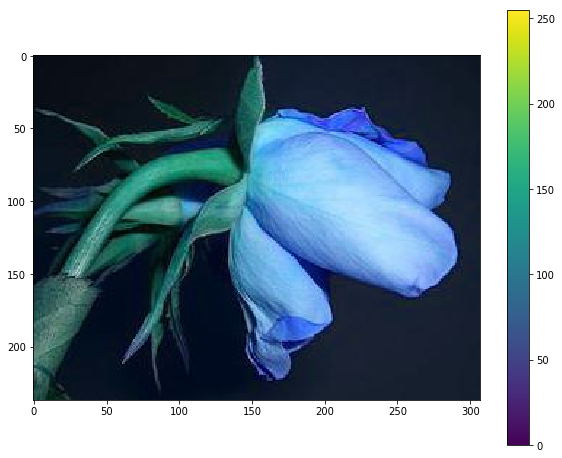

In [119]:
#Setting an approximate rectangle to cut fromthe above script
import numpy as np
import cv2
from matplotlib import pyplot as plt
from PIL import Image
img = cv2.imread('images/cropped-flower.jpg')
mask = np.zeros(img.shape[:2],np.uint8)

bgdModel = np.zeros((1,65),np.float64)
fgdModel = np.zeros((1,65),np.float64)

#Result copied here
rect = (19,14,273,198)
cv2.grabCut(img,mask,rect,bgdModel,fgdModel,5,cv2.GC_INIT_WITH_RECT)
mask2 = np.where((mask==2)|(mask==0),0,1).astype('uint8')
output = img*mask2[:,:,np.newaxis]

plt.imshow(img)
plt.colorbar()
plt.show()
cv2.imwrite("images/paste6_image.png", output);

In [14]:
#Result of cv2.seamlessClone
# Use the mouse below and 
#Notice the center of the overlaid image center = (160,300)
import matplotlib
import numpy as np
import mpld3
import matplotlib.pyplot as plt
from PIL import Image
from mpld3 import plugins
%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0)

fig, ax = plt.subplots()
im = np.array(Image.open('images/paste8_image.png'))
plt.imshow(im)
plugins.connect(fig, plugins.MousePosition(fontsize=20))

mpld3.display()

In [128]:
import cv2
import numpy as np 
#Setting an approximate rectangle to cut fromthe above script
import numpy as np
import cv2
from matplotlib import pyplot as plt

img = cv2.imread('images/paste6_image.png')
mask = np.zeros(img.shape[:2],np.uint8)

bgdModel = np.zeros((1,65),np.float64)
fgdModel = np.zeros((1,65),np.float64)

#Result copied here
rect = (50,54,225,255)
cv2.grabCut(img,mask,rect,bgdModel,fgdModel,5,cv2.GC_INIT_WITH_RECT)
mask2 = np.where((mask==2)|(mask==0),0,1).astype('uint8')
#img = img*mask2[:,:,np.newaxis]
src = img*mask2[:,:,np.newaxis]
#plt.imshow(img)
#plt.colorbar()
#plt.show()

# Read images
dst = cv2.imread("images/desert.jpg")

cv2.imwrite("images/paste7_image.png", output);


In [ ]:
import cv2
import numpy as np 
#Setting an approximate rectangle to cut fromthe above script
import numpy as np
import cv2
from matplotlib import pyplot as plt
from PIL import Image
img = cv2.imread('images/paste6_image.png')
mask = np.zeros(img.shape[:2],np.uint8)

bgdModel = np.zeros((1,65),np.float64)
fgdModel = np.zeros((1,65),np.float64)

#Result copied here
rect = (50,54,225,255)
cv2.grabCut(img,mask,rect,bgdModel,fgdModel,5,cv2.GC_INIT_WITH_RECT)
mask2 = np.where((mask==2)|(mask==0),0,1).astype('uint8')
#img = img*mask2[:,:,np.newaxis]
src = img*mask2[:,:,np.newaxis]

dst = cv2.imread("images/desert.jpg")
#--------------------------

im = np.array(Image.open('images/paste7_image.png'))



#src_mask = np.zeros(src.shape, src.dtype)

poly = np.array([
[ 14 , 66 ],

[ 9 , 66 ]
], np.int32)

#cv2.fillPoly(im, img, (255, 255, 255))
#cv2.fillPoly(src_mask, img, (255, 255, 255))

# This is where the CENTER where the cactus will be placed. If it overlaps the bottomimage edge
# it will give an error.

center = (300,300)

# Clone seamlessly.
output = cv2.seamlessClone(src, dst, im, center, cv2.NORMAL_CLONE)

# Write result
cv2.imwrite("images/paste5_image.png", output);


In [ ]:
import cv2
import numpy as np 

# Read images
dst = cv2.imread("images/resized-desert.jpg")

src = cv2.imread("images/crop_specsimage.png")


# Create a rough mask around the cactus.
src_mask = np.zeros(src.shape, src.dtype)

poly = np.array([
[ 14 , 66 ],
[ 45 , 45 ],
[ 70 , 25 ],
[ 98 , 12 ],
[ 126 , 6 ],
[ 154 , 16 ],
[ 171 , 34 ],
[ 189 , 54 ],
[ 212 , 67 ],
[ 206 , 82 ],
[ 236 , 85 ],
[ 282 , 136 ],
[ 268 , 171 ],
[ 265 , 207 ],
[ 260 , 237 ],
[ 304 , 317 ],
[ 267 , 329 ],
[ 234 , 290 ],
[ 204 , 329 ],
[ 131 , 313 ],
[ 84 , 255 ],
[ 82 , 223 ],
[ 122 , 210 ],
[ 80 , 202 ],
[ 65 , 165 ],
[ 61 , 152 ],
[ 30 , 159 ],
[ 81 , 109 ],
[ 9 , 66 ]
], np.int32)


cv2.fillPoly(src_mask, [poly], (255, 255, 255))

# This is where the CENTER where the cactus will be placed. If it overlaps the bottomimage edge
# it will give an error.

center = (160,300)

# Clone seamlessly.
output = cv2.seamlessClone(src, dst, src_mask, center, cv2.NORMAL_CLONE)

# Write result
cv2.imwrite("images/paste2_image.png", output);


In [1]:
#Result of cv2.seamlessClone
# Use the mouse below and 
#Notice the center of the overlaid image center = (160,300)
import matplotlib
import numpy as np
import mpld3
import matplotlib.pyplot as plt
from PIL import Image
from mpld3 import plugins
%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0)

fig, ax = plt.subplots()
im = np.array(Image.open('images/flower.jpg'))
plt.imshow(im)
plugins.connect(fig, plugins.MousePosition(fontsize=20))

mpld3.display()

# -----------------------------------------------